<a href="https://colab.research.google.com/github/zhangjt1/Music-Tools/blob/main/MIDI_Modification.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [10]:
# Uncomment to install dependecies to run on Colab:
!sudo apt-get install fluidsynth
!pip install pretty_midi mir_eval pyfluidsynth

import pretty_midi
import numpy as np
# For plotting
import mir_eval.display
import librosa.display
import matplotlib.pyplot as plt
%matplotlib inline
# For putting audio in the notebook
import IPython.display

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
fluidsynth is already the newest version (2.2.5-1).
0 upgraded, 0 newly installed, 0 to remove and 20 not upgraded.


In [30]:
# load in MIDI file
from pydrive2.auth import GoogleAuth
from pydrive2.drive import GoogleDrive
from google.colab import auth
from oauth2client.client import GoogleCredentials

auth.authenticate_user()
gauth = GoogleAuth()
gauth.credentials = GoogleCredentials.get_application_default()
drive = GoogleDrive(gauth)

id='1xbMEEOAN3fmWDKz0IXQ2qJNAjICXe6Dh'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('bass.mid')

id='1O_8Vu5ShfXMXz8RzplxuvRXQxrpN258N'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('guitar1.mid')

id='1X5I7EHgUkza5ehip-KJ3iJyZki4I3c3d'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('guitar2.mid')

id='1xbMEEOAN3fmWDKz0IXQ2qJNAjICXe6Dh'
downloaded = drive.CreateFile({'id': id})
downloaded.GetContentFile('drums.mid')

In [80]:
# List of your MIDI file paths
midi_files = ["bass.mid", "guitar1.mid", "guitar2.mid"] # ignoring drums for now

# Create an empty PrettyMIDI object to hold everything
combined = pretty_midi.PrettyMIDI()

# Loop through and load each file
for midi_file in midi_files:
    pm = pretty_midi.PrettyMIDI(midi_file)
    combined.instruments.append(pm.instruments[0])

In [40]:
def plot_piano_roll(pm, start_pitch, end_pitch, fs=100):
    # Use librosa's specshow function for displaying the piano roll
    librosa.display.specshow(pm.get_piano_roll(fs)[start_pitch:end_pitch],
                             hop_length=1, sr=fs, x_axis='time', y_axis=None,
                             fmin=pretty_midi.note_number_to_hz(start_pitch))

(0.0, 20.0)

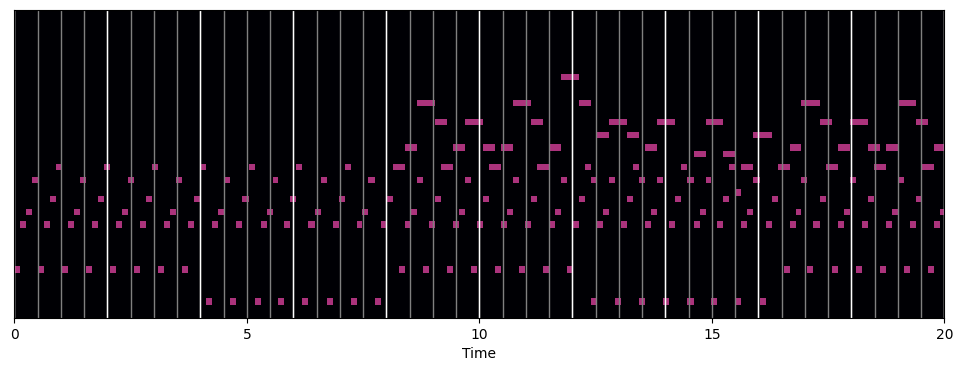

In [54]:
beats = combined.get_beats()
downbeats = combined.get_downbeats()

plt.figure(figsize=(12, 4))

plot_piano_roll(combined, 36, 84)

# Plot beats as grey lines, downbeats as white lines
ymin, ymax = plt.ylim()

for beat in beats:
    plt.plot([beat, beat], [ymin, ymax], color='grey', linewidth=1)
for beat in downbeats:
    plt.plot([beat, beat], [ymin, ymax], color='white', linewidth=1)

plt.xlim(0, 20)

In [34]:
# Synthesis frequency
fs = 16000
IPython.display.Audio(combined.synthesize(fs=16000), rate=16000)
# Sounds like sine waves...

In [84]:
beats = combined.get_beats()

combined.instruments[0].notes

# divide notes by beats
beat_idx = 1
curr_beat = beats[beat_idx]

grouped_notes = []

temp = []
for note in combined.instruments[0].notes:
  if curr_beat <= note.start:
    grouped_notes.append(temp)
    temp = []
    beat_idx += 1
    curr_beat = beats[beat_idx]
  temp.append(note)

def scrambled(groups):
  for group in groups:
    # notes within group randomly swap start and end times
    i = np.random.randint(0, len(group))
    j = np.random.randint(0, len(group))
    group[i].start, group[j].start = group[j].start, group[i].start
    group[i].end, group[j].end = group[j].end, group[i].end
  return groups

scrambled = scrambled(grouped_notes)

flattened = [note for group in scrambled for note in group]

inst = pretty_midi.Instrument(program=42, is_drum=False, name='test')
inst.notes = flattened

IPython.display.Audio(inst.synthesize(fs=16000), rate=16000)